### Part 01. Load packages and libs

In [1]:
import os
import time
import warnings
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary

from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2

torch.cuda.empty_cache()

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

warnings.filterwarnings("ignore")

c:\Users\minht\anaconda3\envs\pydl\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Part 02. Writing a custom dataset for Blood Cell Segmemtation dataset, write data loader to load data for train model

In [2]:
TRAIN_IMG_DIR = "datasets/kvasir_v1/train/images"
TRAIN_MASK_DIR = "datasets/kvasir_v1/train/masks"
VAL_IMG_DIR = "datasets/kvasir_v1/test/images"
VAL_MASK_DIR = "datasets/kvasir_v1/test/masks"

In [3]:
class BloodCellDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None) -> None:
        super(BloodCellDataset, self).__init__()
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(
            self.mask_dir, self.images[index])

        image = np.array(Image.open(image_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"),
                        dtype=np.float32)  # l -> grayscale
        # mask[mask == 255.0] = 1.0
        mask = np.where(mask > 155.0, 1.0, 0.0)

        if self.transform is not None:
            augemantations = self.transform(image=image, mask=mask)
            image = augemantations['image']
            mask = augemantations['mask']
        return image, mask

In [4]:
def get_data_loaders(
        train_dir, train_mask_dir, val_dir, val_maskdir, batch_size,
        train_transform, val_transform):

    train_ds = BloodCellDataset(
        image_dir=train_dir, mask_dir=train_mask_dir,
        transform=train_transform)

    train_loader = DataLoader(
        train_ds,
        batch_size=batch_size,
        shuffle=True,
    )

    val_ds = BloodCellDataset(
        image_dir=val_dir,
        mask_dir=val_maskdir,
        transform=val_transform,
    )

    val_loader = DataLoader(
        val_ds,
        batch_size=batch_size,
        shuffle=False,
    )

    return train_loader, val_loader

In [5]:
train_transform = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [6]:
BATCH_SIZE = 12

train_loader, val_loader = get_data_loaders(
    TRAIN_IMG_DIR,
    TRAIN_MASK_DIR,
    VAL_IMG_DIR,
    VAL_MASK_DIR,
    BATCH_SIZE,
    train_transform,
    val_transforms
)

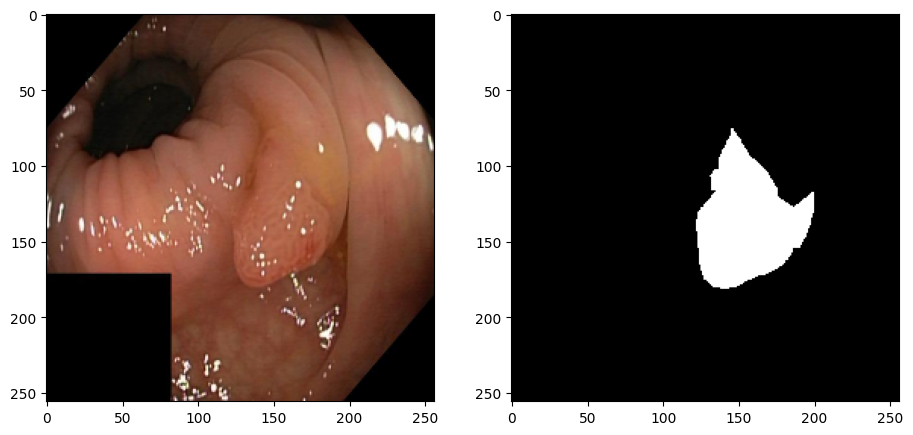

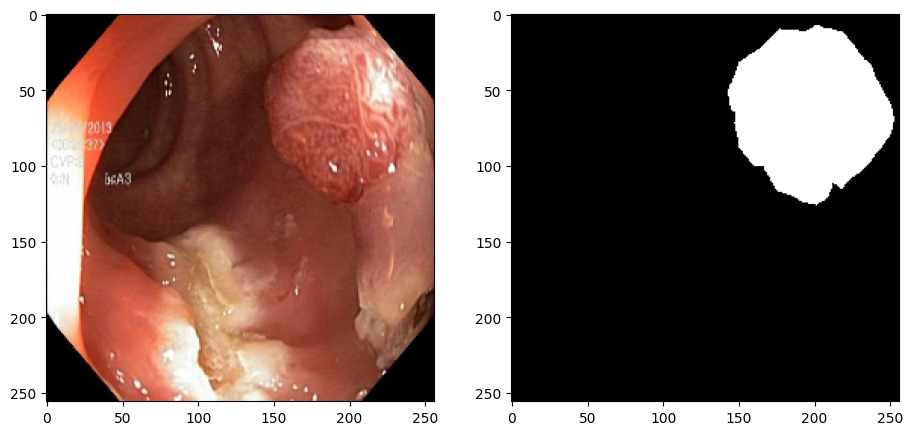

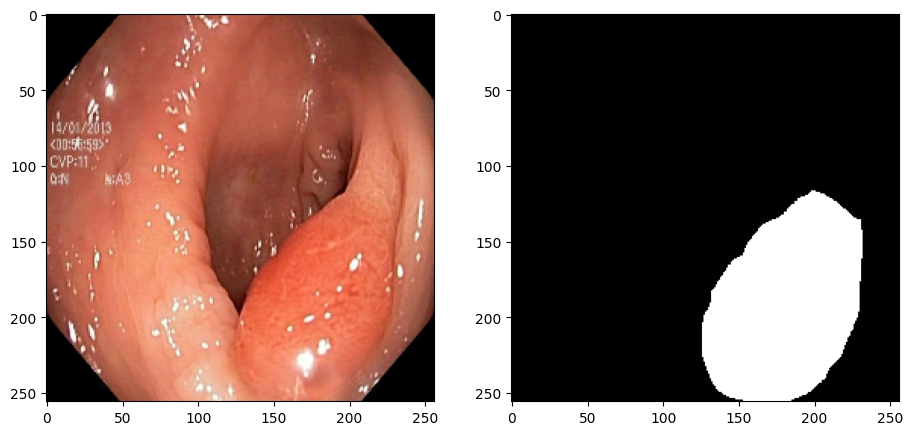

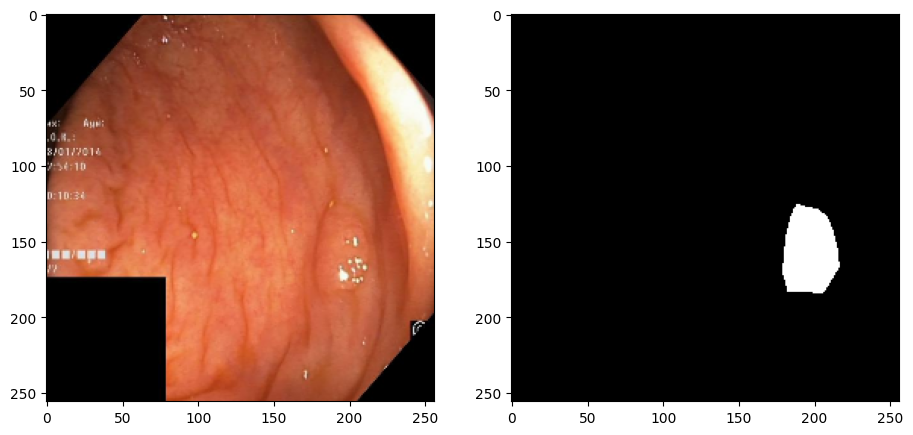

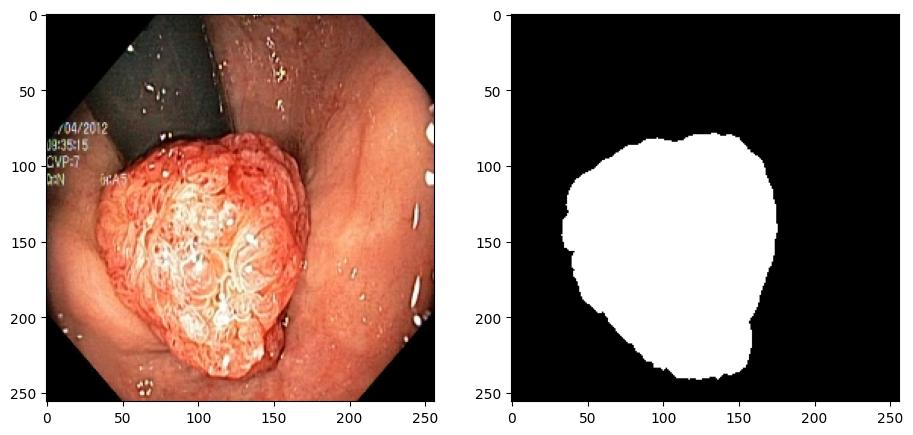

...

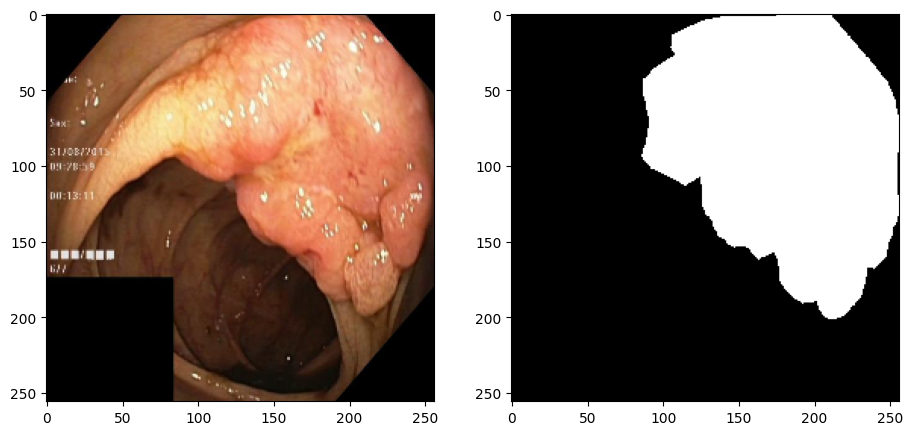

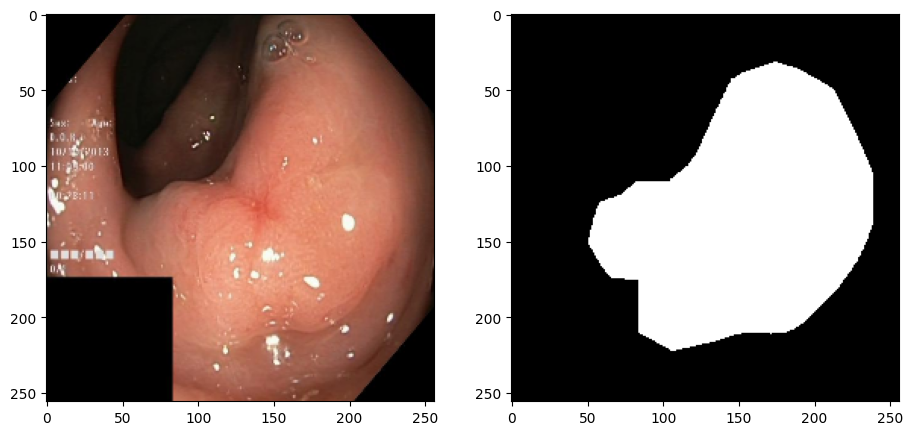

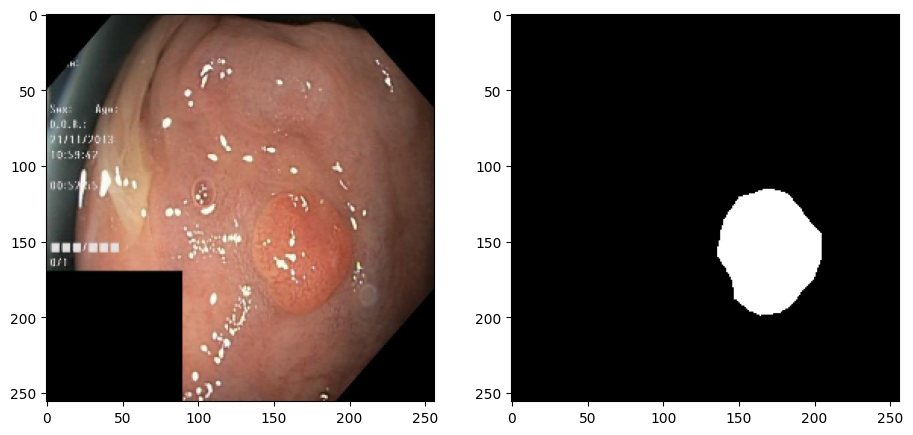

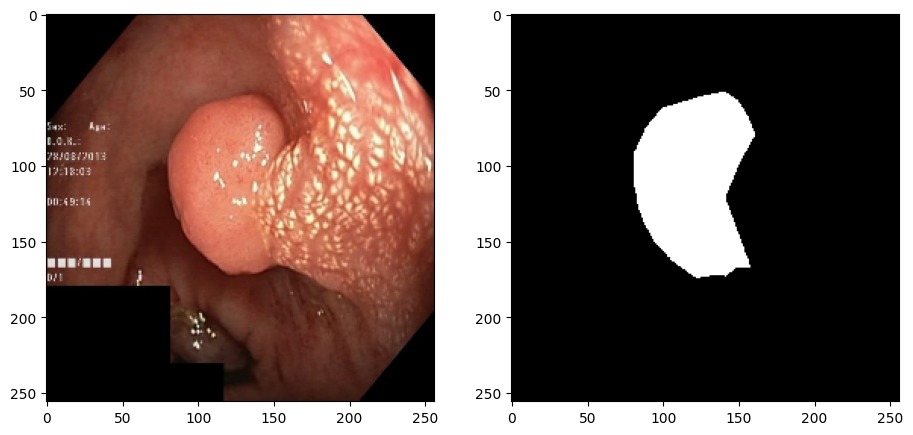

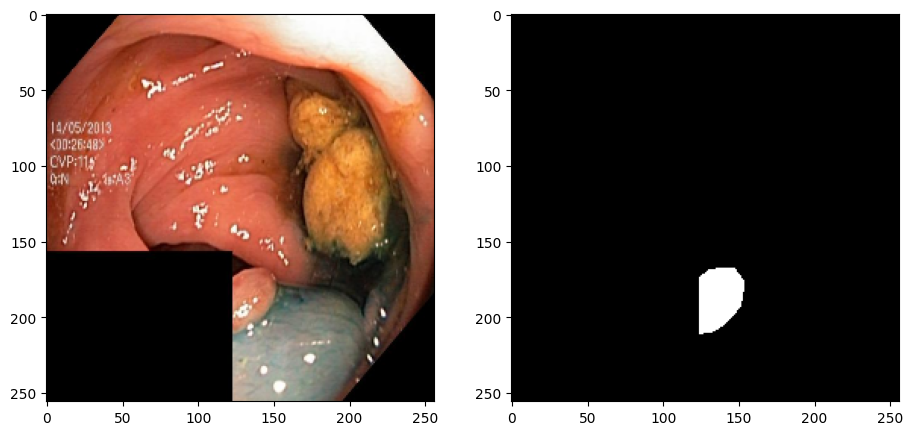

In [7]:
def show_transformed(data_loader):
    batch = next(iter(data_loader))
    images, labels = batch

    for img, mask in zip(images, labels):
        plt.figure(figsize=(11, 11))

        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(img, (1, 2, 0)))

        plt.subplot(1, 2, 2)
        # plt.imshow(mask.reshape(mask.shape[0], mask.shape[1], 1))
        plt.imshow(mask, cmap="gray")


show_transformed(val_loader)

In [8]:
train_loader.dataset[0][0].shape
train_loader.dataset[0][1].shape

torch.Size([256, 256])

In [9]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()
        self.bce_losss = nn.BCEWithLogitsLoss()

    def forward(self, inputs, targets, smooth=1):
        BCE = self.bce_losss(inputs, targets)
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(
            inputs.sum() + targets.sum() + smooth)
        Dice_BCE = BCE + dice_loss
        return Dice_BCE

class IOU(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(IOU, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection

        IoU = (intersection + smooth)/(union + smooth)
        return IoU

In [10]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()

        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels,
                      kernel_size=3, padding=1, bias=False),
            # nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),

            nn.Conv2d(mid_channels, out_channels,
                      kernel_size=3, padding=1, bias=False),
            # nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

In [11]:
class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

In [12]:
class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        if bilinear:
            self.up = nn.Upsample(
                scale_factor=2, mode='bilinear', align_corners=True)
            self.conb = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(
                in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])

        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

In [13]:
class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

In [14]:
class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=False):
        super(UNet, self).__init__()

        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.input = DoubleConv(n_channels, 32)
        self.down1 = Down(32, 64)
        self.down2 = Down(64, 128)
        self.down3 = Down(128, 256)

        factor = 2 if bilinear else 1
        self.down4 = Down(256, 512)

        self.up1 = Up(512, 256 // factor, bilinear)
        self.up2 = Up(256, 128 // factor, bilinear)
        self.up3 = Up(128, 64 // factor, bilinear)
        self.up4 = Up(64, 32, bilinear)

        self.outc = OutConv(32, n_classes)

    def forward(self, x):

        x1 = self.input(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)

        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)

        output = self.outc(x)
        return output

    def use_checkpointing(self):
        self.input = torch.utils.checkpoint(self.input)
        self.down1 = torch.utils.checkpoint(self.down1)
        self.down2 = torch.utils.checkpoint(self.down2)
        self.down3 = torch.utils.checkpoint(self.down3)
        self.down4 = torch.utils.checkpoint(self.down4)
        self.up1 = torch.utils.checkpoint(self.up1)
        self.up2 = torch.utils.checkpoint(self.up2)
        self.up3 = torch.utils.checkpoint(self.up3)
        self.up4 = torch.utils.checkpoint(self.up4)
        self.outc = torch.utils.checkpoint(self.outc)

In [15]:
model = UNet(n_channels=3, n_classes=1).to(DEVICE)
loss_fn = DiceBCELoss()

iou_fn = IOU()
scaler = torch.cuda.amp.GradScaler()
LEARNING_RATE = 1e-4
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_iou = []
train_loss = []
train_dice = []

def save_checkpoint(state, filename="model.pth.tar"):
    print("=> Saving checkpoint")
    # torch.save(state, filename)

In [16]:
summary(model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 256, 256]             864
              ReLU-2         [-1, 32, 256, 256]               0
            Conv2d-3         [-1, 32, 256, 256]           9,216
              ReLU-4         [-1, 32, 256, 256]               0
        DoubleConv-5         [-1, 32, 256, 256]               0
         MaxPool2d-6         [-1, 32, 128, 128]               0
            Conv2d-7         [-1, 64, 128, 128]          18,432
              ReLU-8         [-1, 64, 128, 128]               0
            Conv2d-9         [-1, 64, 128, 128]          36,864
             ReLU-10         [-1, 64, 128, 128]               0
       DoubleConv-11         [-1, 64, 128, 128]               0
             Down-12         [-1, 64, 128, 128]               0
        MaxPool2d-13           [-1, 64, 64, 64]               0
           Conv2d-14          [-1, 128,

In [17]:
model

UNet(
  (input): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): ReLU(inplace=True)
      (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): ReLU(inplace=True)
    )
  )
  (down1): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): ReLU(inplace=True)
          (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (3): ReLU(inplace=True)
        )
      )
    )
  )
  (down2): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(64,

In [18]:
print(model)

UNet(
  (input): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): ReLU(inplace=True)
      (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): ReLU(inplace=True)
    )
  )
  (down1): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): ReLU(inplace=True)
          (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (3): ReLU(inplace=True)
        )
      )
    )
  )
  (down2): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(64,

In [19]:
start_time = time.time()

# let's train it just for 2 epochs
NUM_EPOCHS = 32

for epoch in range(NUM_EPOCHS):
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}")

    iterations = 0
    iter_loss = 0.0
    iter_iou = 0.0

    batch_loop = tqdm(train_loader)
    for batch_idx, (data, targets) in enumerate(batch_loop):

        data = data.to(device=DEVICE)
        targets = targets.float().unsqueeze(1).to(device=DEVICE)

        with torch.cuda.amp.autocast():
        # with torch.autocast(device_type=DEVICE, dtype=torch.bfloat16):
            predictions = model(data)
            loss = loss_fn(predictions, targets)
            iou = iou_fn(predictions, targets)

            iter_loss += loss.item()
            iter_iou += iou.item()

        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        iterations += 1
        batch_loop.set_postfix(diceloss=loss.item(), iou=iou.item())

    train_loss.append(iter_loss / iterations)
    train_iou.append(iter_iou / iterations)
    # print(
    #     f"Epoch: {epoch+1}/{NUM_EPOCHS}, Training loss: {round(train_loss[-1] , 3)}")
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}, IoU score: {iter_iou / iterations}")

    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict()
    }
    # save_checkpoint(checkpoint)

    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()
            num_correct += (preds == y).sum()
            num_pixels += torch.numel(preds)
            dice_score += (2 * (preds * y).sum()) / (
                (preds + y).sum() + 1e-8
            )

    # print(
    #     f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.2f}"
    # )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Total num_correct/num_pixels: {num_correct}/{num_pixels} => {num_correct/num_pixels}"
    )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Dice score: {dice_score / len(val_loader)}")
    train_dice.append(dice_score / len(val_loader))
    model.train()

print("done ..")

end_time = time.time()
training_time = end_time - start_time
print(
    f"The training time of the UNET model is: {training_time:.2f} seconds")

Epoch: 1/32


100%|██████████| 67/67 [09:06<00:00,  8.15s/it, diceloss=1.29, iou=0.0803]


Epoch: 1/32, IoU score: 0.11677046159087721
Epoch: 1/32, Total num_correct/num_pixels: 11175870/13107200 => 0.8526512384414673
Epoch: 1/32, Dice score: 0.0
Epoch: 2/32


100%|██████████| 67/67 [08:48<00:00,  7.89s/it, diceloss=1.11, iou=0.198] 


Epoch: 2/32, IoU score: 0.1385780431663812
Epoch: 2/32, Total num_correct/num_pixels: 11175870/13107200 => 0.8526512384414673
Epoch: 2/32, Dice score: 0.0
Epoch: 3/32


100%|██████████| 67/67 [08:41<00:00,  7.79s/it, diceloss=1.05, iou=0.141] 


Epoch: 3/32, IoU score: 0.1873371161854089
Epoch: 3/32, Total num_correct/num_pixels: 10977818/13107200 => 0.8375410437583923
Epoch: 3/32, Dice score: 0.36367638673976016
Epoch: 4/32


100%|██████████| 67/67 [08:43<00:00,  7.82s/it, diceloss=0.955, iou=0.188]


Epoch: 4/32, IoU score: 0.20391263401330406
Epoch: 4/32, Total num_correct/num_pixels: 11180153/13107200 => 0.852977991104126
Epoch: 4/32, Dice score: 0.32570537482165635
Epoch: 5/32


100%|██████████| 67/67 [08:37<00:00,  7.73s/it, diceloss=1.03, iou=0.125] 


Epoch: 5/32, IoU score: 0.21522288869565992
Epoch: 5/32, Total num_correct/num_pixels: 10762256/13107200 => 0.8210949897766113
Epoch: 5/32, Dice score: 0.44899172325602565
Epoch: 6/32


100%|██████████| 67/67 [09:09<00:00,  8.20s/it, diceloss=0.943, iou=0.249]


Epoch: 6/32, IoU score: 0.23767286628039916
Epoch: 6/32, Total num_correct/num_pixels: 10762204/13107200 => 0.8210909962654114
Epoch: 6/32, Dice score: 0.4666544777738909
Epoch: 7/32


100%|██████████| 67/67 [08:55<00:00,  7.99s/it, diceloss=1, iou=0.225]    


Epoch: 7/32, IoU score: 0.2489005534061745
Epoch: 7/32, Total num_correct/num_pixels: 10984707/13107200 => 0.8380666375160217
Epoch: 7/32, Dice score: 0.46392724512286304
Epoch: 8/32


100%|██████████| 67/67 [08:40<00:00,  7.76s/it, diceloss=0.873, iou=0.3]  


Epoch: 8/32, IoU score: 0.2605978701986484
Epoch: 8/32, Total num_correct/num_pixels: 11098397/13107200 => 0.8467404842376709
Epoch: 8/32, Dice score: 0.46450694946088406
Epoch: 9/32


100%|██████████| 67/67 [09:32<00:00,  8.55s/it, diceloss=0.915, iou=0.244]


Epoch: 9/32, IoU score: 0.24918192358159308
Epoch: 9/32, Total num_correct/num_pixels: 11062427/13107200 => 0.8439962267875671
Epoch: 9/32, Dice score: 0.47931664709749705
Epoch: 10/32


100%|██████████| 67/67 [06:43<00:00,  6.02s/it, diceloss=0.896, iou=0.265]


Epoch: 10/32, IoU score: 0.27143171874444877
Epoch: 10/32, Total num_correct/num_pixels: 11171337/13107200 => 0.8523053526878357
Epoch: 10/32, Dice score: 0.4661533707207936
Epoch: 11/32


100%|██████████| 67/67 [06:13<00:00,  5.57s/it, diceloss=1.05, iou=0.295] 


Epoch: 11/32, IoU score: 0.2746809351800093
Epoch: 11/32, Total num_correct/num_pixels: 11312382/13107200 => 0.8630662560462952
Epoch: 11/32, Dice score: 0.4630727886092014
Epoch: 12/32


100%|██████████| 67/67 [05:27<00:00,  4.89s/it, diceloss=0.931, iou=0.257]


Epoch: 12/32, IoU score: 0.27547233073569055
Epoch: 12/32, Total num_correct/num_pixels: 11306148/13107200 => 0.8625906109809875
Epoch: 12/32, Dice score: 0.4575079309796313
Epoch: 13/32


100%|██████████| 67/67 [05:17<00:00,  4.74s/it, diceloss=0.76, iou=0.346] 


Epoch: 13/32, IoU score: 0.2819408881130503
Epoch: 13/32, Total num_correct/num_pixels: 11118942/13107200 => 0.8483079671859741
Epoch: 13/32, Dice score: 0.5105304407770866
Epoch: 14/32


100%|██████████| 67/67 [06:09<00:00,  5.51s/it, diceloss=1.11, iou=0.215] 


Epoch: 14/32, IoU score: 0.287409790416262
Epoch: 14/32, Total num_correct/num_pixels: 11282070/13107200 => 0.8607536554336548
Epoch: 14/32, Dice score: 0.5021727810515939
Epoch: 15/32


100%|██████████| 67/67 [06:30<00:00,  5.82s/it, diceloss=0.972, iou=0.205]


Epoch: 15/32, IoU score: 0.29196142149505333
Epoch: 15/32, Total num_correct/num_pixels: 11446535/13107200 => 0.8733013272285461
Epoch: 15/32, Dice score: 0.43207039365221833
Epoch: 16/32


100%|██████████| 67/67 [05:45<00:00,  5.15s/it, diceloss=0.905, iou=0.22] 


Epoch: 16/32, IoU score: 0.29407835073435484
Epoch: 16/32, Total num_correct/num_pixels: 11468171/13107200 => 0.8749520182609558
Epoch: 16/32, Dice score: 0.44696750140630365
Epoch: 17/32


100%|██████████| 67/67 [05:53<00:00,  5.28s/it, diceloss=0.954, iou=0.248]


Epoch: 17/32, IoU score: 0.30282613612822634
Epoch: 17/32, Total num_correct/num_pixels: 11084372/13107200 => 0.8456704616546631
Epoch: 17/32, Dice score: 0.5185907827672744
Epoch: 18/32


100%|██████████| 67/67 [06:35<00:00,  5.90s/it, diceloss=0.897, iou=0.293]


Epoch: 18/32, IoU score: 0.2893574217807001
Epoch: 18/32, Total num_correct/num_pixels: 11355063/13107200 => 0.8663225769996643
Epoch: 18/32, Dice score: 0.5076562220111225
Epoch: 19/32


100%|██████████| 67/67 [07:02<00:00,  6.31s/it, diceloss=0.929, iou=0.235]


Epoch: 19/32, IoU score: 0.3024849293392096
Epoch: 19/32, Total num_correct/num_pixels: 11290825/13107200 => 0.8614215850830078
Epoch: 19/32, Dice score: 0.5045970884724709
Epoch: 20/32


100%|██████████| 67/67 [05:33<00:00,  4.99s/it, diceloss=0.939, iou=0.28] 


Epoch: 20/32, IoU score: 0.30564346331268993
Epoch: 20/32, Total num_correct/num_pixels: 11114932/13107200 => 0.848002016544342
Epoch: 20/32, Dice score: 0.5294311035996727
Epoch: 21/32


100%|██████████| 67/67 [05:17<00:00,  4.74s/it, diceloss=0.792, iou=0.422]


Epoch: 21/32, IoU score: 0.3088306008435007
Epoch: 21/32, Total num_correct/num_pixels: 10687310/13107200 => 0.8153770565986633
Epoch: 21/32, Dice score: 0.5204857389958378
Epoch: 22/32


100%|██████████| 67/67 [05:20<00:00,  4.79s/it, diceloss=0.805, iou=0.293]


Epoch: 22/32, IoU score: 0.3092986440925456
Epoch: 22/32, Total num_correct/num_pixels: 11391513/13107200 => 0.8691034913063049
Epoch: 22/32, Dice score: 0.5226265763095195
Epoch: 23/32


100%|██████████| 67/67 [05:27<00:00,  4.89s/it, diceloss=0.924, iou=0.248]


Epoch: 23/32, IoU score: 0.309614724410114
Epoch: 23/32, Total num_correct/num_pixels: 11425181/13107200 => 0.8716721534729004
Epoch: 23/32, Dice score: 0.5325075432164444
Epoch: 24/32


100%|██████████| 67/67 [05:16<00:00,  4.72s/it, diceloss=0.835, iou=0.287]


Epoch: 24/32, IoU score: 0.32555693988479784
Epoch: 24/32, Total num_correct/num_pixels: 11557821/13107200 => 0.8817917704582214
Epoch: 24/32, Dice score: 0.5072674717627544
Epoch: 25/32


100%|██████████| 67/67 [05:23<00:00,  4.83s/it, diceloss=0.79, iou=0.314] 


Epoch: 25/32, IoU score: 0.3269461106453369
Epoch: 25/32, Total num_correct/num_pixels: 11272688/13107200 => 0.8600378632545471
Epoch: 25/32, Dice score: 0.5444276375836665
Epoch: 26/32


100%|██████████| 67/67 [05:16<00:00,  4.72s/it, diceloss=0.683, iou=0.403]


Epoch: 26/32, IoU score: 0.3266513476620859
Epoch: 26/32, Total num_correct/num_pixels: 11166995/13107200 => 0.8519741296768188
Epoch: 26/32, Dice score: 0.5470035080121725
Epoch: 27/32


100%|██████████| 67/67 [05:32<00:00,  4.96s/it, diceloss=1.07, iou=0.275] 


Epoch: 27/32, IoU score: 0.33663669361997006
Epoch: 27/32, Total num_correct/num_pixels: 11536081/13107200 => 0.8801331520080566
Epoch: 27/32, Dice score: 0.5430075347399947
Epoch: 28/32


100%|██████████| 67/67 [05:13<00:00,  4.68s/it, diceloss=0.688, iou=0.375]


Epoch: 28/32, IoU score: 0.3336468105440709
Epoch: 28/32, Total num_correct/num_pixels: 11287070/13107200 => 0.8611351251602173
Epoch: 28/32, Dice score: 0.5533175614928023
Epoch: 29/32


100%|██████████| 67/67 [05:15<00:00,  4.71s/it, diceloss=0.786, iou=0.299]


Epoch: 29/32, IoU score: 0.34478062925054065
Epoch: 29/32, Total num_correct/num_pixels: 11592897/13107200 => 0.8844678401947021
Epoch: 29/32, Dice score: 0.55833150588248
Epoch: 30/32


100%|██████████| 67/67 [05:15<00:00,  4.71s/it, diceloss=0.601, iou=0.479]


Epoch: 30/32, IoU score: 0.3526810565546377
Epoch: 30/32, Total num_correct/num_pixels: 11312237/13107200 => 0.8630551695823669
Epoch: 30/32, Dice score: 0.5598384262000176
Epoch: 31/32


100%|██████████| 67/67 [05:13<00:00,  4.68s/it, diceloss=0.834, iou=0.322]


Epoch: 31/32, IoU score: 0.3517912136974619
Epoch: 31/32, Total num_correct/num_pixels: 11519818/13107200 => 0.8788923621177673
Epoch: 31/32, Dice score: 0.5713217457078026
Epoch: 32/32


100%|██████████| 67/67 [05:13<00:00,  4.69s/it, diceloss=0.704, iou=0.388]


Epoch: 32/32, IoU score: 0.3613212742467425
Epoch: 32/32, Total num_correct/num_pixels: 11499859/13107200 => 0.8773696422576904
Epoch: 32/32, Dice score: 0.5814776959425074
done ..
The training time of the UNET model is: 13825.67 seconds


In [20]:
print(train_loss)

[1.3841187811609525, 1.1957409773299943, 1.0600390541019724, 1.0347381625602494, 1.0151649944817842, 0.9930037847205774, 0.9724965905075642, 0.9570603326185426, 0.9802100516077298, 0.9366403773649415, 0.9298183428707407, 0.9352976297264668, 0.91502910140735, 0.9063358164545315, 0.9011757578422774, 0.8932584123824959, 0.8816440603626308, 0.9074660352806547, 0.8808847096428942, 0.8780192617160171, 0.8663994954593146, 0.8713118941036623, 0.8732741724199323, 0.8388767963025108, 0.8398126025698078, 0.8411953698343305, 0.8196589973435473, 0.8266041430074778, 0.8076126771186715, 0.7974040899703752, 0.7945823020009852, 0.7780678868293762]


In [21]:
print(train_iou)

[0.11677046159087721, 0.1385780431663812, 0.1873371161854089, 0.20391263401330406, 0.21522288869565992, 0.23767286628039916, 0.2489005534061745, 0.2605978701986484, 0.24918192358159308, 0.27143171874444877, 0.2746809351800093, 0.27547233073569055, 0.2819408881130503, 0.287409790416262, 0.29196142149505333, 0.29407835073435484, 0.30282613612822634, 0.2893574217807001, 0.3024849293392096, 0.30564346331268993, 0.3088306008435007, 0.3092986440925456, 0.309614724410114, 0.32555693988479784, 0.3269461106453369, 0.3266513476620859, 0.33663669361997006, 0.3336468105440709, 0.34478062925054065, 0.3526810565546377, 0.3517912136974619, 0.3613212742467425]


In [22]:
print(train_dice)

[tensor(0., dtype=torch.float64), tensor(0., dtype=torch.float64), tensor(0.3637, dtype=torch.float64), tensor(0.3257, dtype=torch.float64), tensor(0.4490, dtype=torch.float64), tensor(0.4667, dtype=torch.float64), tensor(0.4639, dtype=torch.float64), tensor(0.4645, dtype=torch.float64), tensor(0.4793, dtype=torch.float64), tensor(0.4662, dtype=torch.float64), tensor(0.4631, dtype=torch.float64), tensor(0.4575, dtype=torch.float64), tensor(0.5105, dtype=torch.float64), tensor(0.5022, dtype=torch.float64), tensor(0.4321, dtype=torch.float64), tensor(0.4470, dtype=torch.float64), tensor(0.5186, dtype=torch.float64), tensor(0.5077, dtype=torch.float64), tensor(0.5046, dtype=torch.float64), tensor(0.5294, dtype=torch.float64), tensor(0.5205, dtype=torch.float64), tensor(0.5226, dtype=torch.float64), tensor(0.5325, dtype=torch.float64), tensor(0.5073, dtype=torch.float64), tensor(0.5444, dtype=torch.float64), tensor(0.5470, dtype=torch.float64), tensor(0.5430, dtype=torch.float64), tensor(0

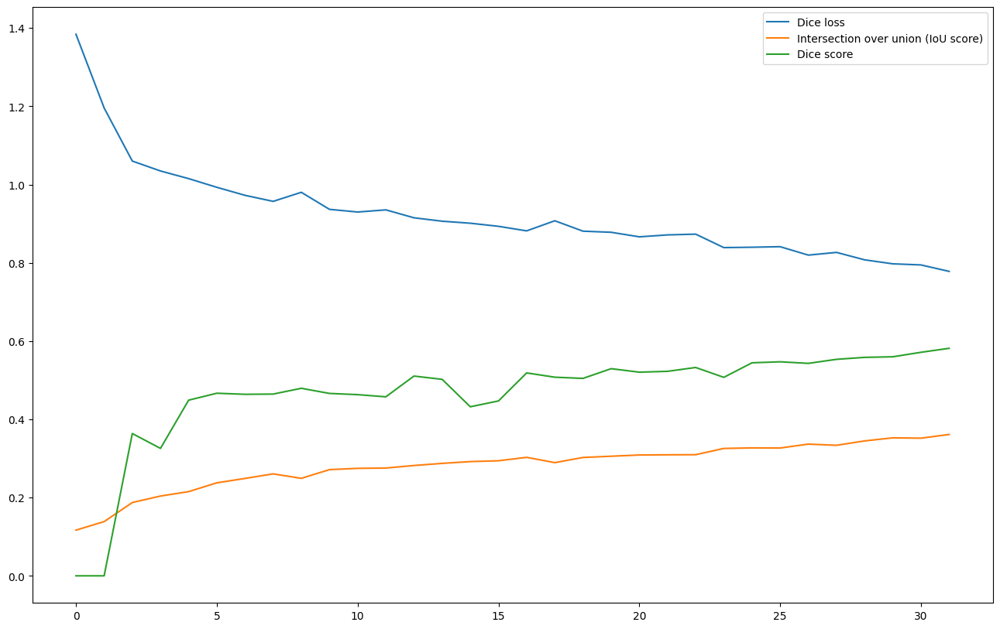

In [23]:
f = plt.figure(figsize=(16, 10))
plt.plot(train_loss, label='Dice loss')
plt.plot(train_iou, label='Intersection over union (IoU score)')
plt.plot(train_dice, label='Dice score')
plt.legend()
plt.show()

In [24]:
def test_model(model, val_loader, device):
    model.eval()
    dice_score = 0
    iou_metric = IOU()
    iou_score = 0

    with torch.no_grad():
        for x, y in tqdm(val_loader, desc="Testing"):
            x = x.to(device)
            y = y.to(device).unsqueeze(1)

            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            dice_score += (2 * (preds_binary * y).sum()) / (
                (preds_binary + y).sum() + 1e-8
            )
            iou_score += iou_metric(preds_binary, y)

    avg_dice = dice_score / len(val_loader)
    avg_iou = iou_score / len(val_loader)

    print(f"Average Dice Score: {avg_dice:.4f}")
    print(f"Average IoU Score: {avg_iou:.4f}")

    return avg_dice, avg_iou

avg_dice, avg_iou = test_model(model, val_loader, DEVICE)

Testing: 100%|██████████| 17/17 [00:29<00:00,  1.76s/it]

Average Dice Score: 0.5815
Average IoU Score: 0.1589


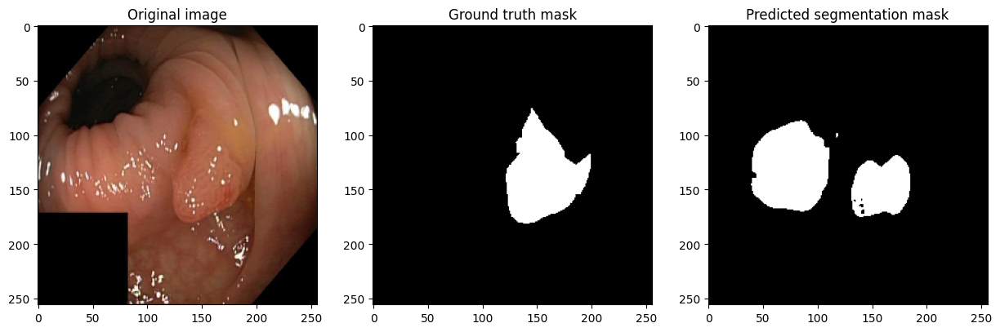

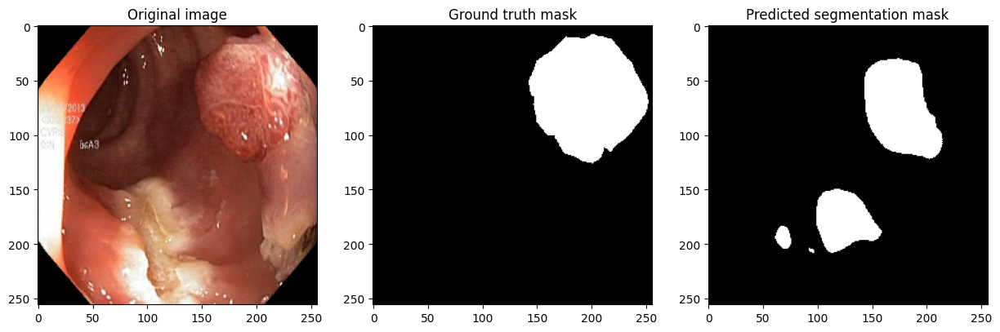

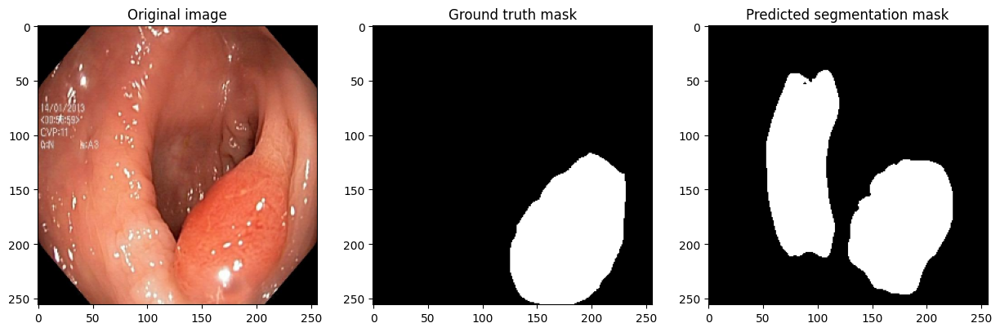

In [25]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(15, 5))

                plt.subplot(1, 3, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                plt.subplot(1, 3, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                plt.subplot(1, 3, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.show()
                samples += 1

            if samples >= num_samples:
                break

visualize_predictions(model, val_loader, DEVICE)

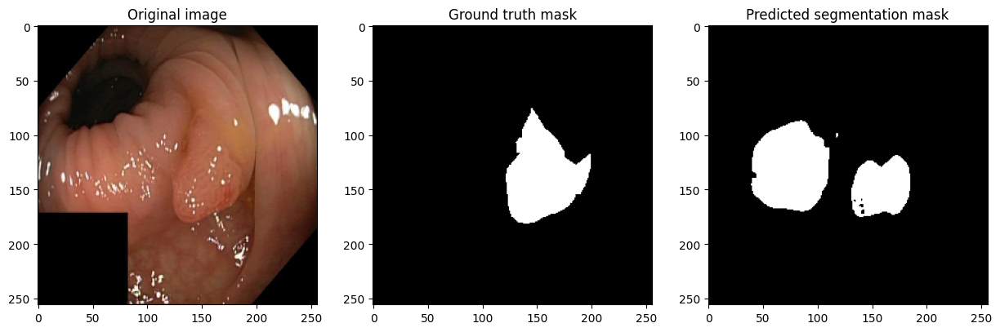

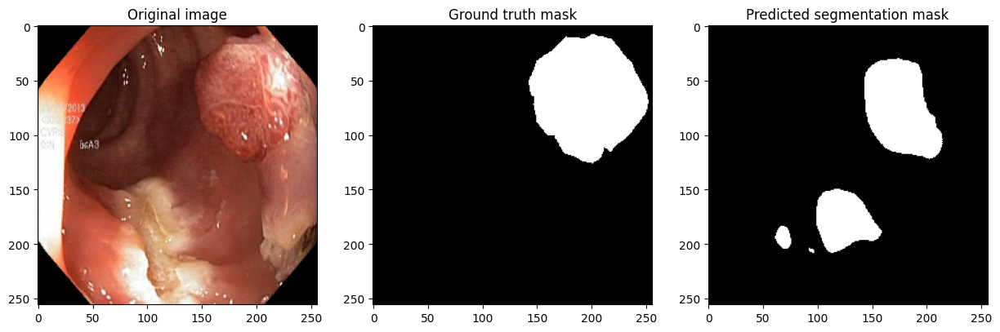

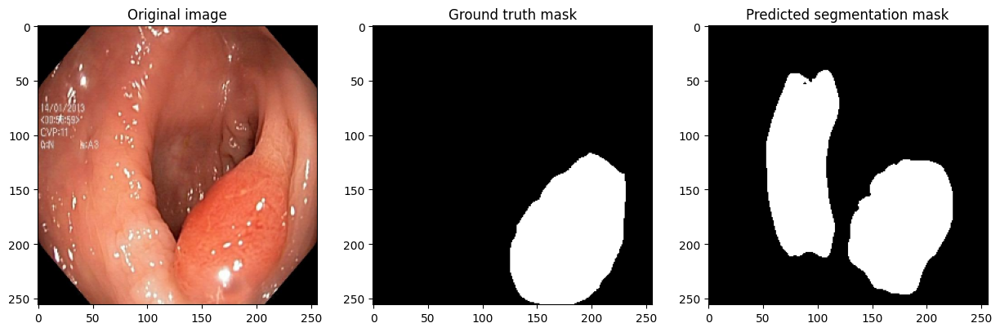

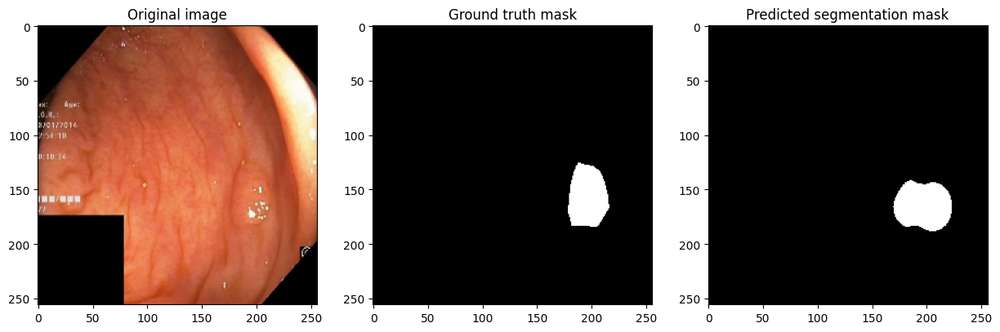

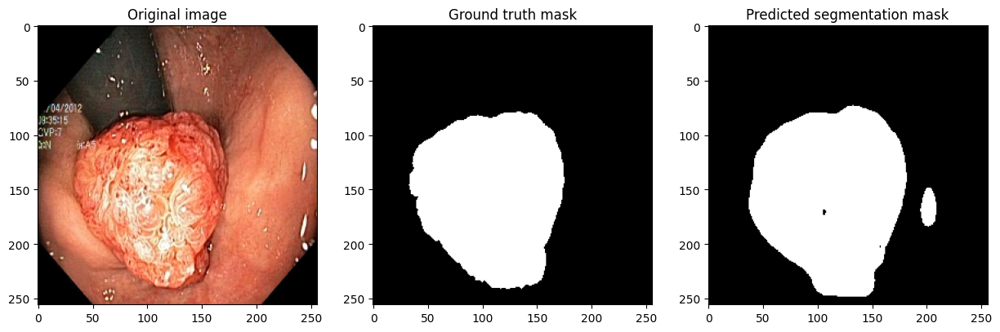

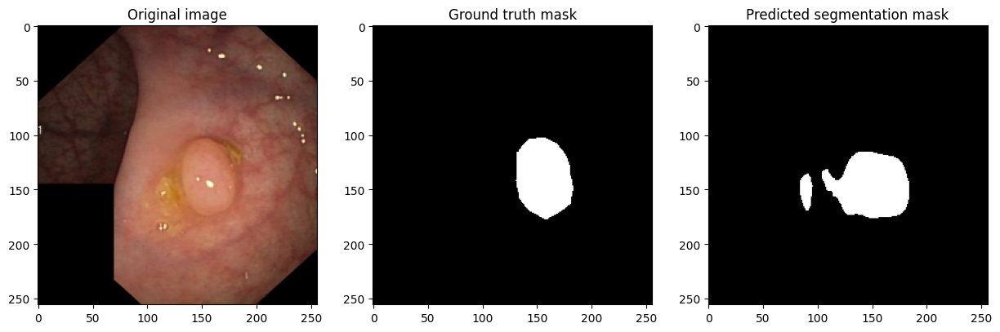

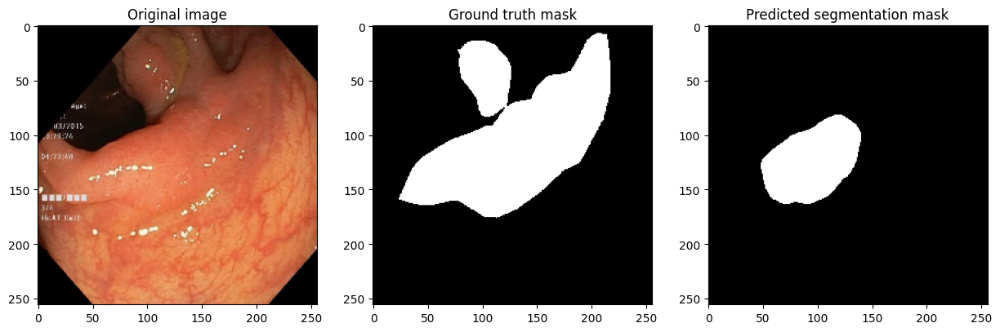

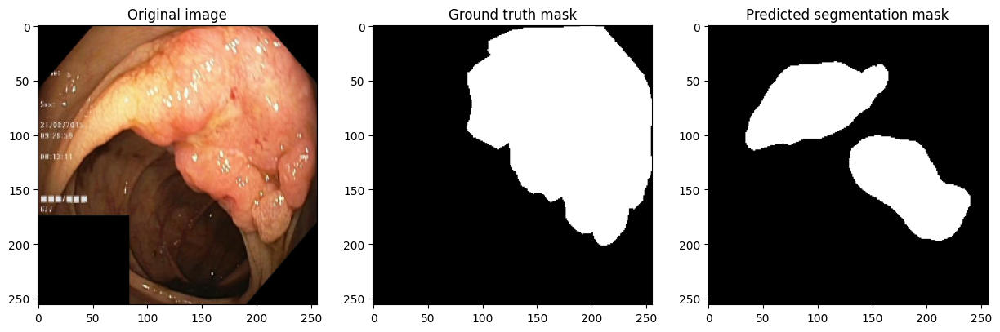

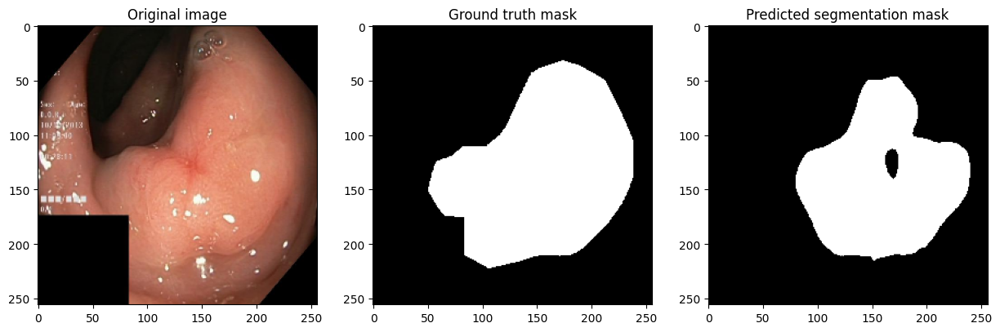

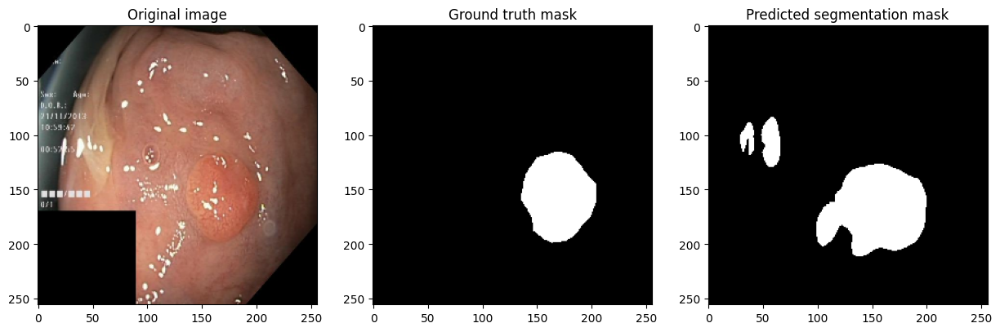

In [26]:
visualize_predictions(model, val_loader, DEVICE, num_samples=10)

In [27]:
# visualize_predictions(model, val_loader, DEVICE, num_samples=50)

In [28]:
# visualize_predictions(model, val_loader, DEVICE, num_samples=100)

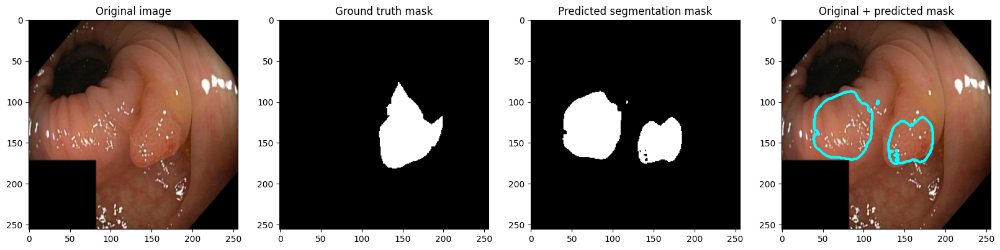

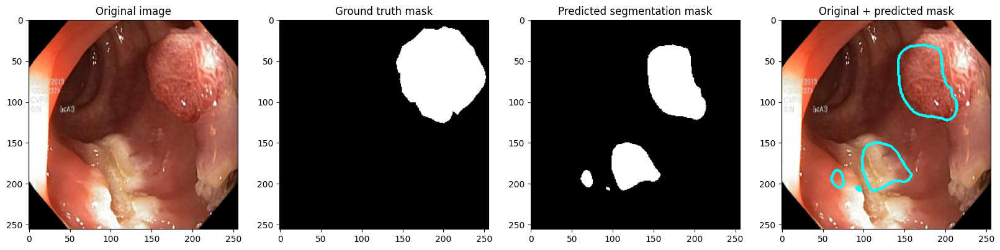

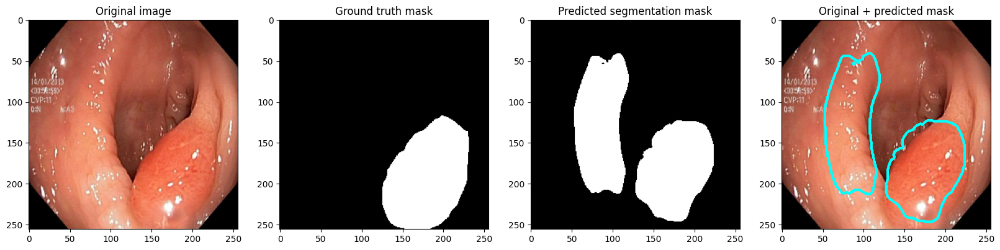

In [29]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(20, 5))

                plt.subplot(1, 4, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                plt.subplot(1, 4, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                plt.subplot(1, 4, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.subplot(1, 4, 4)
                plt.title("Original + predicted mask")
                original_image = np.transpose(x[i].cpu().numpy(), (1, 2, 0))
                plt.imshow(original_image)

                mask = preds_binary[i].cpu().numpy().squeeze()
                mask_border = np.zeros_like(mask)
                mask_border[mask == 1] = 1
                plt.contour(mask_border, colors='cyan', linewidths=2)

                plt.show()
                samples += 1

            if samples >= num_samples:
                break


visualize_predictions(model, val_loader, DEVICE)

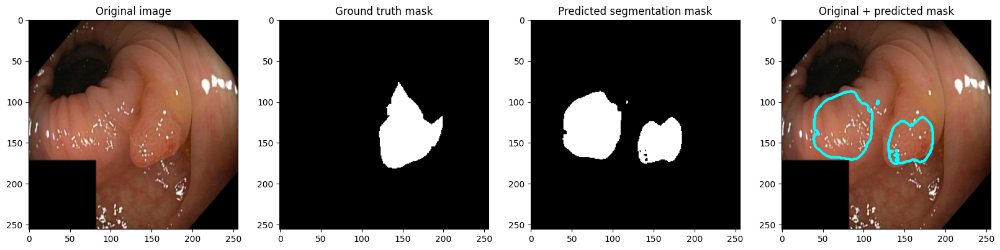

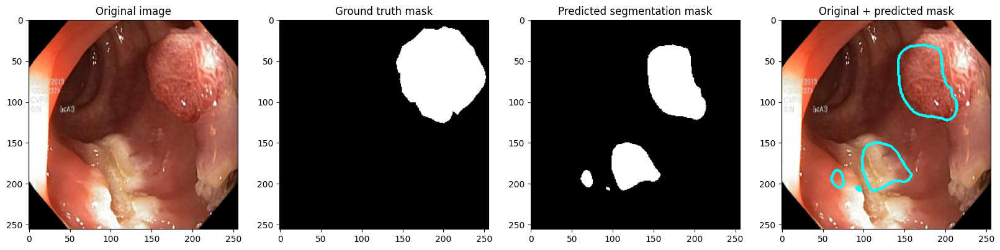

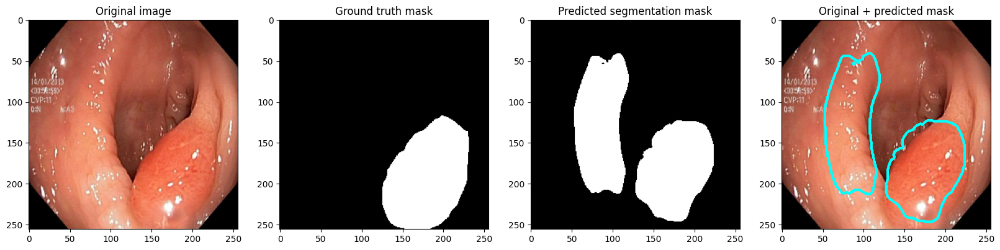

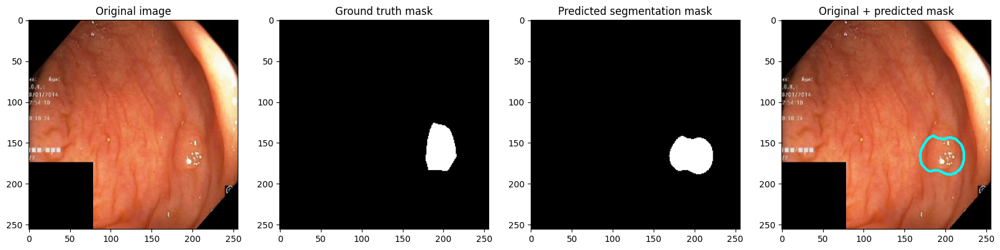

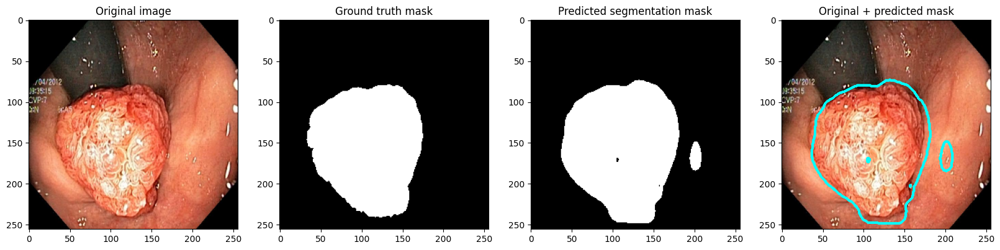

...

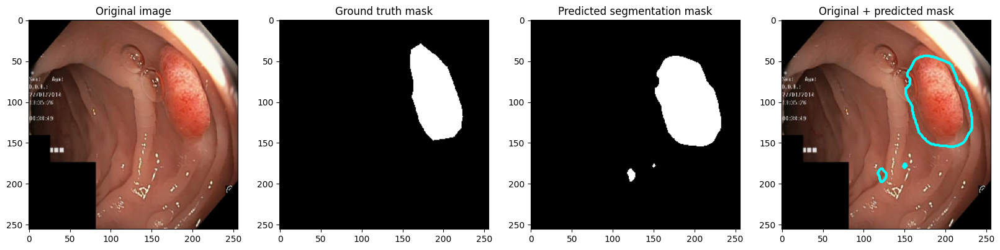

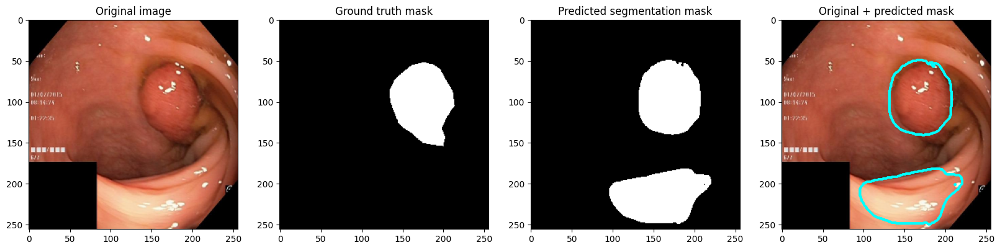

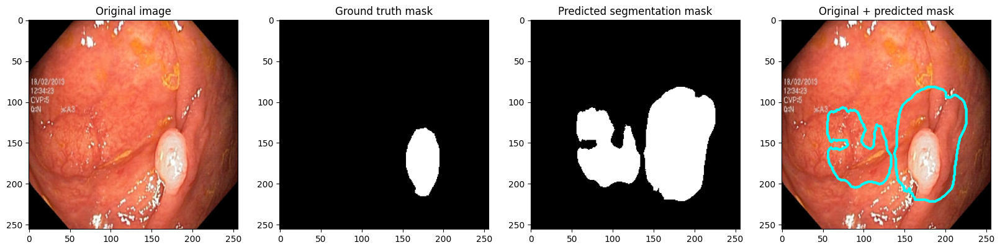

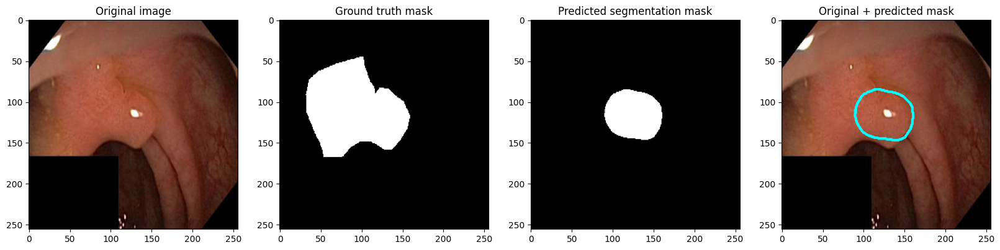

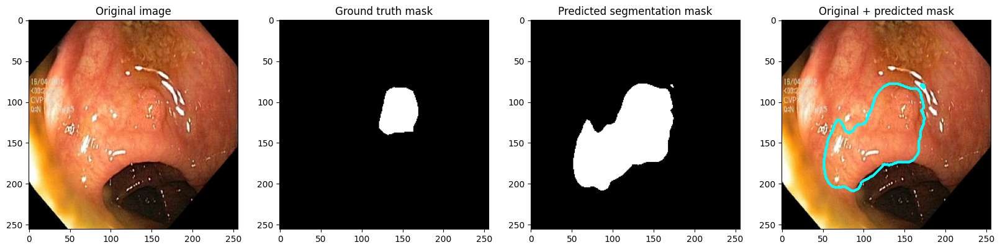

In [30]:
visualize_predictions(model, val_loader, DEVICE, num_samples=100)